# 1 Utils

In [56]:
import pandas as pd
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from matplotlib.backends.backend_pdf import PdfPages
sns.set_style("whitegrid")

# 2 Single File Visualization


In [107]:
col_names = ['Data','Hora', 'Vent', 
             'Unkwn1', 'Unkwn2', 
             'Fase',  'TBS', 'TBU', 'UR', 'Unkwn3', 'Duracion_fase', 
             'UMd', 'Um1', 'Um2', 'Um3', 'Um4', 'Um5', 'Um6', 'Um7', 'Um8', 
             'Ext1', 'Ext2', 'Ext3', 'Ext4', 'Ext5', 'Ext6', 'Ext7', 'Ext8', 'Ext9', 'Ext10', 'Ext11', 'Ext12', 
             'Ext13', 'Ext14', 'Ext15', 'Ext16', 'Ext17', 'Ext18', 'Ext19', 'Ext20', 'Ext21', 'Ext22', 'Ext23', 'Ext24',
             'TBS1', 'TBU1', 'UR1', 'TBS2', 'TBU2', 'UR2', 
             'Exte1','Exte2','Exte3','Exte4','Exte5','Exte6','Exte7','Exte8','Exte9','Exte10','Exte11', 
             'time_step','Unkwn4', 'Vent_dir']
print(len(col_names))

64


In [ ]:
df = pd.read_csv('..\\Datos\\ts_2016\\'+'E0102066.TXT', sep='\t', header=None)
df.columns = col_names
print(df.head())
new_index = pd.to_datetime(df['Data']+' '+df['Hora'], dayfirst=True)
f = plt.figure()
df =df.set_index(new_index)
df[['Fase','TBS','TBU','UR','Vent_dir']].plot(kind='line',figsize=(20,10),label='Inline label')
plt.show()

# 3 Data Preparation
!!!!No correr si ya se separo en camaras!!!!

In [8]:
# Devuelve una lista de DataFrames
def load_year_files(year, verbose=False):
    file_names = [os.path.basename(x) for x in glob.glob('..\\Datos\\ts_'+year+'/[!~]*.TXT')]
    dir_files = glob.glob('..\\Datos\\ts_' + year  +'/[!~]*.TXT')
    print('Total Archivos',len(file_names))
    print(len(dir_files))
    
    caldera_list = []
    caldera_names = []
    camara_dict = {}
    proceso = 0
    for file_name in file_names:
        try:
            df = pd.read_csv('..\\Datos\\ts_'+year+'/'+file_name, sep='\t', header=None)
            new_index =  pd.to_datetime(df[0]+' '+df[1], dayfirst=True)
            df = df.set_index(new_index)
            df['nro_camara'] = (file_name[:3])[2]
            df['proceso'] = '{}'.format(file_name)
            df = df.drop([0,1], axis=1)
            caldera_list.append(df)
            proceso += 1
            camara_dict[file_name] = df
            steps = df.shape[0]
            
            assert len(df.columns) == len(col_names[2:])
            try:
                df.columns = col_names[2:]
            except ValueError:
                print('Error')
                
        except ValueError:
            print('Some error reading file with pandas')
            continue

    caldera = pd.concat(caldera_list)
    print(caldera.shape)
    return caldera_list, camara_dict, caldera

def clean_mydf(df):
    caldera_mean = df.describe()
    caldera_mean = caldera_mean.loc['mean',:]
    caldera_mean_tmp = caldera_mean.reset_index()
    drop_columns= caldera_mean_tmp.loc[caldera_mean_tmp['mean'] == 0].set_index('index').index.values
    df = df.drop(drop_columns,axis=1)
    return df

In [111]:
def save_plots(df_list, cols, year):
    for df in df_list:
        fname = df.proceso.tolist()[0].split('.')[0]
        steps = df.shape[0]
        f = plt.figure(figsize=(20,5))
        ax = df.sort_index()[cols].plot(figsize=(20,5))
        ax.legend(bbox_to_anchor=(1.0,0.5), loc='center left')
        plt.title("{} cycle".format(fname))
        plt.xlabel('Time steps {}'.format(steps))
        plt.ylabel('Observation')
        
        plt.gcf().savefig('img_ts_{}\\{}.png'.format(year,fname))

# 4 Load, Create and Save Data
!!!!No correr si ya se separo en camaras!!!!

In [106]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 12}

plt.rc('font', **font)

## 4.1 Load Data

In [17]:
col_names.extend(['nro_camara','proceso'])

In [9]:
cl_2018, cd_2018, cc_2018 = load_year_files('2018')
cl_2017, cd_2017, cc_2017 = load_year_files('2017')
cl_2016, cd_2016, cc_2016 = load_year_files('2016')
# c_2015 = load_year_files('2015')
# c_2014 = load_year_files('2014')
print('Done')

Total Archivos 143
143
Total Archivos 266
266
Total Archivos 191
191
Done


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


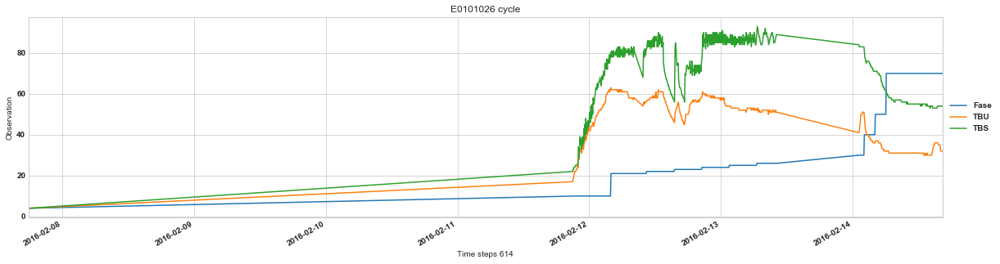

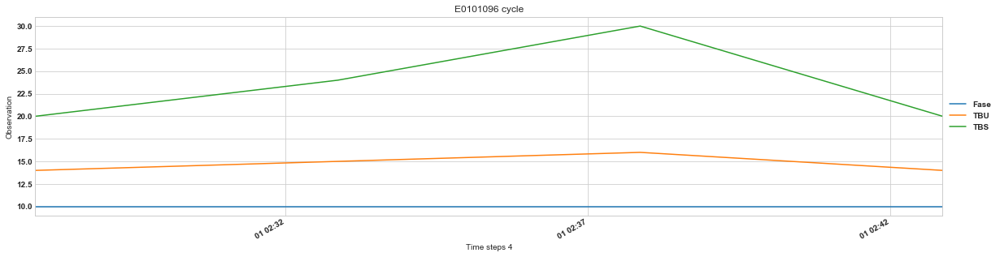

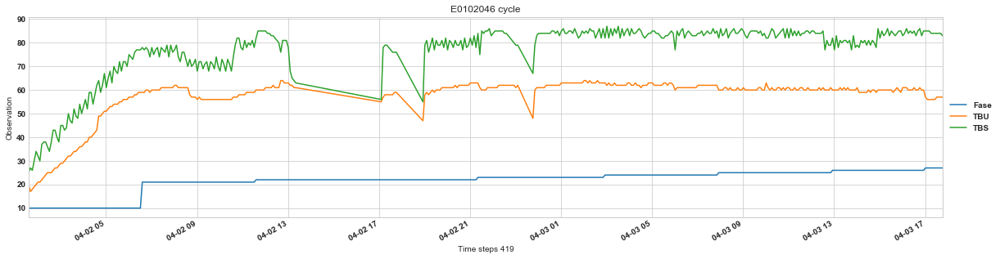

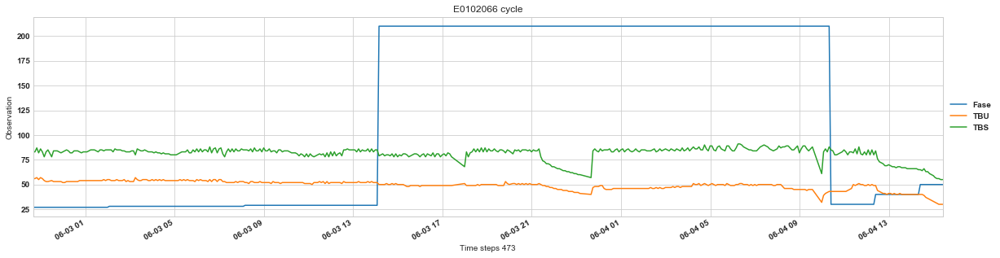

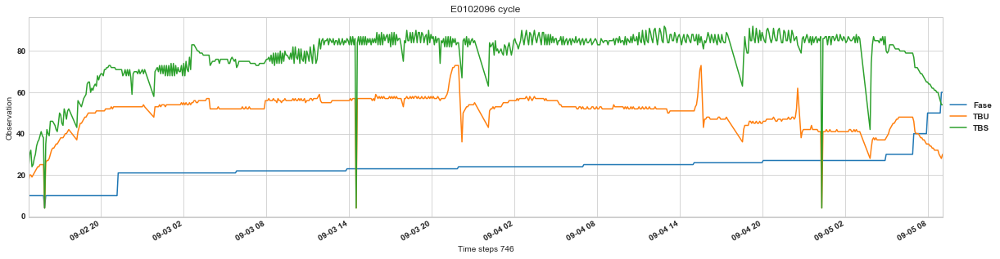

...

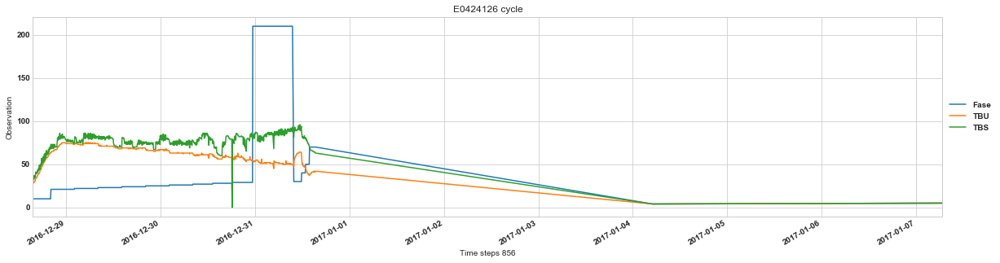

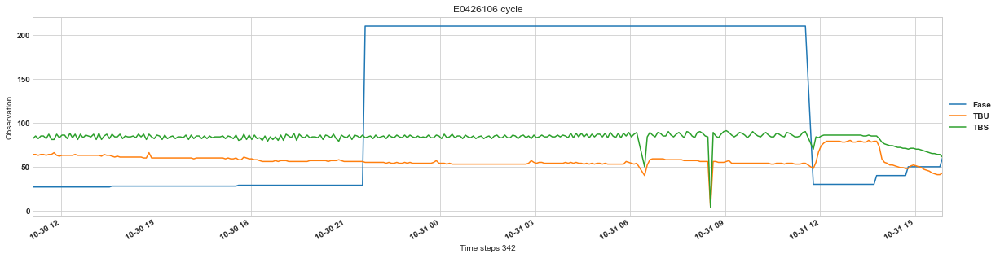

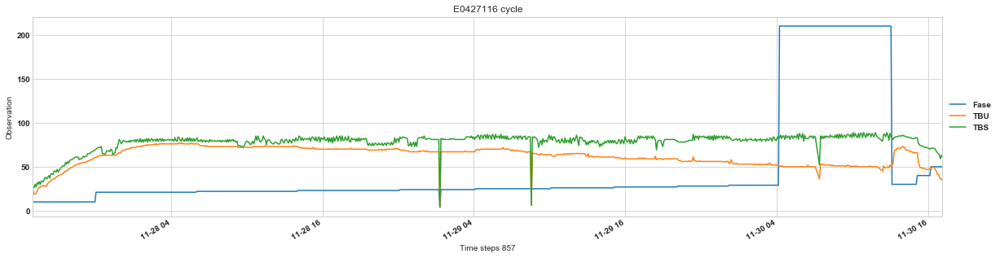

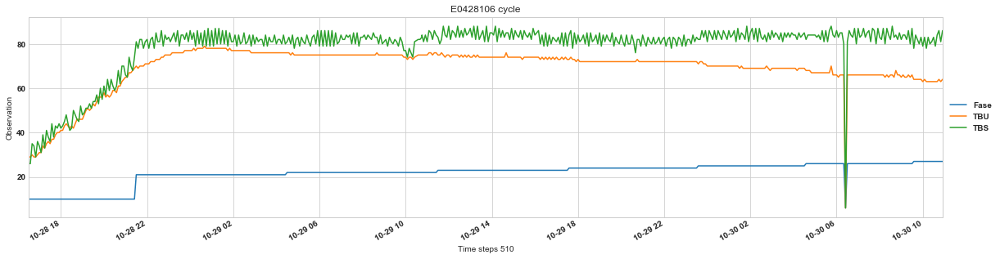

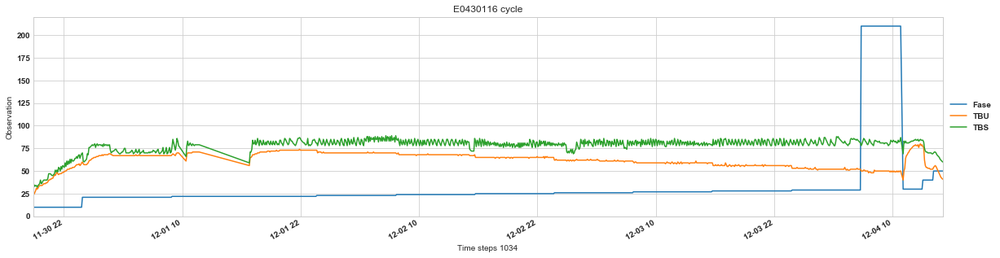

In [112]:
save_plots(cc_2016, ['Fase','TBU', 'TBS'], 2016)

In [ ]:
save_plots(c_2018, ['TBU', 'TBS', 'UR'], 2018)

In [18]:
chambers = pd.concat([cc_2016,cc_2017,cc_2018])
print(chambers.shape)
print(chambers.head())


(512147, 64)
                    Vent Unkwn1  Unkwn2  Fase   TBS   TBU    UR  Unkwn3  \
2016-02-07 17:47:52           L     0.0   4.0   4.0   4.0   1.0     0.0   
2016-02-11 20:59:52   <-      L     0.0  10.0  22.0  17.0  73.0     0.0   
2016-02-11 21:04:53   <-      L     0.0  10.0  23.0  18.0  73.0     0.0   
2016-02-11 21:09:53   <-      L     0.0  10.0  23.0  19.0  76.0     0.0   
2016-02-11 21:14:52   <-      L     0.0  10.0  24.0  20.0  76.0     0.0   

                     Duracion_fase  UMd      ...       Exte7  Exte8  Exte9  \
2016-02-07 17:47:52            0.0  0.0      ...         0.0    0.0    0.0   
2016-02-11 20:59:52            1.0  0.0      ...         0.0    0.0    0.0   
2016-02-11 21:04:53            6.0  0.0      ...         0.0    0.0    0.0   
2016-02-11 21:09:53           11.0  0.0      ...         0.0    0.0    0.0   
2016-02-11 21:14:52           16.0  0.0      ...         0.0    0.0    0.0   

                     Exte10  Exte11  time_step  Unkwn4  Vent_dir  n

## 4.2 Clean Data

In [34]:
print(len(chambers.columns))
print(chambers.columns)
print(chambers.head())
# col_names.append('nro_camara')
# col_names.append('proceso')
chambers.columns = col_names[2:]
# chambers.columns = col_names
# chambers = clean_mydf(chambers)
print(chambers.shape)
# chambers.head()

64
Index(['Vent', 'Unkwn1', 'Unkwn2', 'Fase', 'TBS', 'TBU', 'UR', 'Unkwn3',
       'Duracion_fase', 'UMd', 'Um1', 'Um2', 'Um3', 'Um4', 'Um5', 'Um6', 'Um7',
       'Um8', 'Ext1', 'Ext2', 'Ext3', 'Ext4', 'Ext5', 'Ext6', 'Ext7', 'Ext8',
       'Ext9', 'Ext10', 'Ext11', 'Ext12', 'Ext13', 'Ext14', 'Ext15', 'Ext16',
       'Ext17', 'Ext18', 'Ext19', 'Ext20', 'Ext21', 'Ext22', 'Ext23', 'Ext24',
       'TBS1', 'TBU1', 'UR1', 'TBS2', 'TBU2', 'UR2', 'Exte1', 'Exte2', 'Exte3',
       'Exte4', 'Exte5', 'Exte6', 'Exte7', 'Exte8', 'Exte9', 'Exte10',
       'Exte11', 'time_step', 'Unkwn4', 'Vent_dir', 'nro_camara', 'proceso'],
      dtype='object')
                    Vent Unkwn1  Unkwn2  Fase   TBS   TBU    UR  Unkwn3  \
2016-02-07 17:47:52           L     0.0   4.0   4.0   4.0   1.0     0.0   
2016-02-11 20:59:52   <-      L     0.0  10.0  22.0  17.0  73.0     0.0   
2016-02-11 21:04:53   <-      L     0.0  10.0  23.0  18.0  73.0     0.0   
2016-02-11 21:09:53   <-      L     0.0  10.0  23.0  19.0 

## 4.3  Save Data by Chamber

In [35]:
years = ['2018', '2017', '2016']
chambers_lenght = 4
chambers_nro = []
for i in range(len(years)):
    for j in range(1, chambers_lenght + 1):
        print('chamber {} year {}'.format(j,years[i]))
        
        chamber = chambers[chambers['nro_camara']==str(j)].loc[str(years[i])]
        print(chamber.shape)
        
        chamber.sort_index().to_csv('..\\Datos\\ts_{}\\c{}_{}.csv'.format(years[i], j, years[i]))
        print('saved to ..\\Datos\\ts_{}\\c{}_{}.csv'.format(years[i], j, years[i]))

chamber 1 year 2018
(25655, 64)
saved to ..\Datos\ts_2018\c1_2018.csv
chamber 2 year 2018
(8182, 64)
saved to ..\Datos\ts_2018\c2_2018.csv
chamber 3 year 2018
(33092, 64)
saved to ..\Datos\ts_2018\c3_2018.csv
chamber 4 year 2018
(42914, 64)
saved to ..\Datos\ts_2018\c4_2018.csv
chamber 1 year 2017
(14170, 64)
saved to ..\Datos\ts_2017\c1_2017.csv
chamber 2 year 2017
(75984, 64)
saved to ..\Datos\ts_2017\c2_2017.csv
chamber 3 year 2017
(79375, 64)
saved to ..\Datos\ts_2017\c3_2017.csv
chamber 4 year 2017
(76561, 64)
saved to ..\Datos\ts_2017\c4_2017.csv
chamber 1 year 2016
(68388, 64)
saved to ..\Datos\ts_2016\c1_2016.csv
chamber 2 year 2016
(56194, 64)
saved to ..\Datos\ts_2016\c2_2016.csv
chamber 3 year 2016
(13086, 64)
saved to ..\Datos\ts_2016\c3_2016.csv
chamber 4 year 2016
(18539, 64)
saved to ..\Datos\ts_2016\c4_2016.csv


# 5 View Chambers

In [95]:
def load_chamber_data(nro_chamber):
    chamber = 'c{}'.format(nro_chamber)
    c_2016 = pd.read_csv('..\\Datos\\ts_2016\\{}_2016.csv'.format(chamber),parse_dates=['Unnamed: 0'],index_col='Unnamed: 0')
    c_2017 = pd.read_csv('..\\Datos\\ts_2017\\{}_2017.csv'.format(chamber),parse_dates=['Unnamed: 0'],index_col='Unnamed: 0')
    c_2018 = pd.read_csv('..\\Datos\\ts_2018\\{}_2018.csv'.format(chamber),parse_dates=['Unnamed: 0'],index_col='Unnamed: 0')
    c = pd.concat([c_2016,c_2017,c_2018])
    c.set_index(pd.to_datetime(c.index),inplace=True)
    return c

In [96]:
#mantenciones
mantenciones = pd.read_csv('..\\Datos\\mantenciones.csv')
mantenciones.drop(['Unnamed: 1'],axis=1,inplace=True)
mantenciones['Hora'] = mantenciones['Hora'].fillna('23:59')
mantenciones.info(9)

# Mantenciones camara 1
m1 = mantenciones[mantenciones['Camara']=='1']
m1.index = m1.Fecha
m1 = m1.drop(['Fecha'],axis=1)

# Mantenciones camara 2
m2 = mantenciones[mantenciones['Camara']=='2']
m2.index = m2.Fecha
m2 = m2.drop(['Fecha'],axis=1)

# Mantenciones camara 3
m3 = mantenciones[mantenciones['Camara']=='3']
m3.index = m3.Fecha
m3.drop(['Fecha'],axis=1,inplace=True)

# Mantenciones camara 4
m4 = mantenciones[mantenciones['Camara']=='4']
m4.index = m4.Fecha
m4.drop(['Fecha'],axis=1,inplace=True)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121 entries, 0 to 120
Data columns (total 7 columns):
Fecha         121 non-null object
Hora          121 non-null object
Camara        117 non-null object
Objeto        121 non-null object
Problema      120 non-null object
Especifico    118 non-null object
Comentario    119 non-null object
dtypes: object(7)
memory usage: 6.7+ KB


C:\Users\joaquin\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\joaquin\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



## 5.1 Chamber 1

In [97]:

import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

def plot_chamber_serie(serie, fname, tname, mantencion=None, start=None, end=None, end_dates=None, start_dates=None):
    
    if start != None and end==None:
        serie = serie.loc[start]
    elif start!=None and end!=None:
        serie = serie.loc[start:end]
    
    f = plt.figure()
        
    ax= serie.plot(kind='line',figsize=(20,5),sharex=False,sharey=False)
    ax.set_xlabel('Time Step')
    ax.set_ylabel('Temperature (°)')
    ax.set_title(tname)
    patches = []
    
    if len(mantencion) != 0:
        ax.axvline(0,color='red',linestyle='--', label='mantencion')
        for date in mantencion.index:
            ax.axvline(date, color='red', linestyle='--')
    
    if end_dates != None and len(end_dates) != 0:
        ax.axvline(0,color='green', linestyle='-.', label='fin sec')
        for date in end_dates:
            ax.axvline(date,color='green', linestyle='-.')
    
    if start_dates != None and len(start_dates) != 0:
        ax.axvline(0,color='blue', linestyle='-.', label='inicio sec')
        for date in start_dates:
            ax.axvline(date,color='blue', linestyle=':')
    
    ax.legend(bbox_to_anchor=(1.0,1.0),frameon=True,fancybox=True, framealpha=1, shadow=True, borderpad=1)
    plt.show()
    plt.gcf().savefig(fname)

In [98]:
c1 = load_chamber_data(1)
print(c1.shape)
print(c1.columns)

(108213, 64)
Index(['Vent', 'Unkwn1', 'Unkwn2', 'Fase', 'TBS', 'TBU', 'UR', 'Unkwn3',
       'Duracion_fase', 'UMd', 'Um1', 'Um2', 'Um3', 'Um4', 'Um5', 'Um6', 'Um7',
       'Um8', 'Ext1', 'Ext2', 'Ext3', 'Ext4', 'Ext5', 'Ext6', 'Ext7', 'Ext8',
       'Ext9', 'Ext10', 'Ext11', 'Ext12', 'Ext13', 'Ext14', 'Ext15', 'Ext16',
       'Ext17', 'Ext18', 'Ext19', 'Ext20', 'Ext21', 'Ext22', 'Ext23', 'Ext24',
       'TBS1', 'TBU1', 'UR1', 'TBS2', 'TBU2', 'UR2', 'Exte1', 'Exte2', 'Exte3',
       'Exte4', 'Exte5', 'Exte6', 'Exte7', 'Exte8', 'Exte9', 'Exte10',
       'Exte11', 'time_step', 'Unkwn4', 'Vent_dir', 'nro_camara', 'proceso'],
      dtype='object')


In [99]:
c1.drop(c1[c1['proceso']=='2015-66'].index, axis=0, inplace=True)

In [100]:
proces_ends = []
proces_starts = []
steps_count = []
procesos = {}
c1_2016 = c1.loc['2016']
for group, frame in  c1_2016.groupby('proceso'):
    steps = frame['TBU'].count()
    steps_count.append(steps)
    procesos[group] = {'steps':steps, 'inicio':frame.index.tolist()[0], 'termino':frame.index.tolist()[-1]}
#     print(str(frame.index.tolist()[0]))

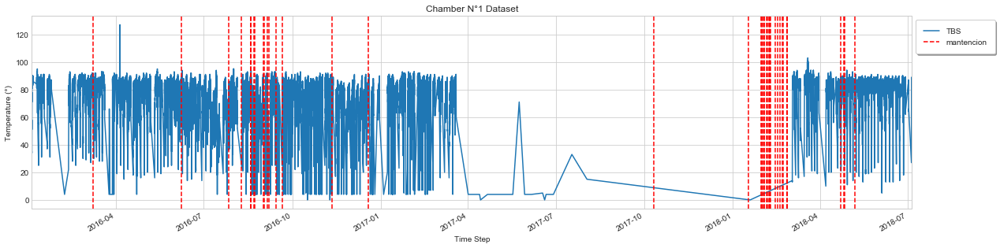

In [101]:
chamber = 1
fname = 'chamber_{}_data.png'.format(chamber)
tname = 'Chamber N°{} Dataset'.format(chamber)
mantencion = m1
serie = c1[['TBS']]
plot_chamber_serie(serie, fname, tname, mantencion=mantencion)

### 5.1.1 Chamber 1: 2016

2016-01-04 21:09:34  to  2018-07-05 15:10:17


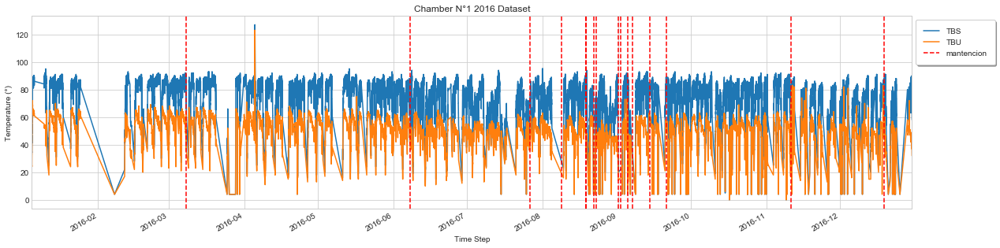

In [102]:
print(c1.index[0],' to ',c1.index[-1])
chamber = 1
year = 2016
fname = 'chamber_{}_{}_data.png'.format(chamber, year)
tname = 'Chamber N°{} {} Dataset'.format(chamber, year)
start = '2016'
mantencion = m1
serie = c1[['TBS','TBU']]
plot_chamber_serie(serie, fname, tname, mantencion=mantencion, start=start)


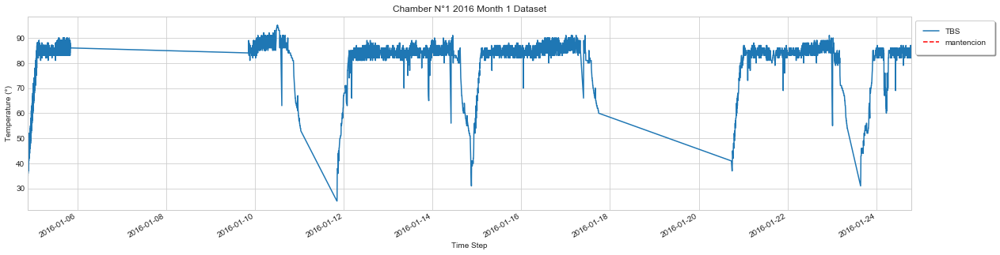

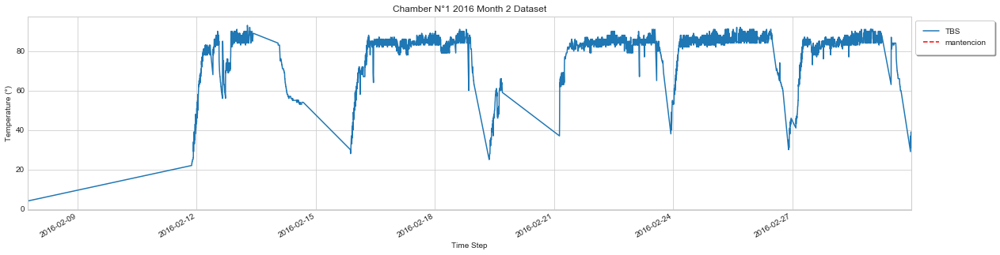

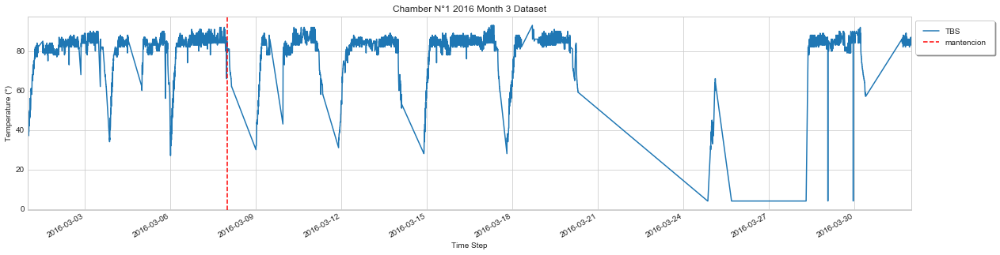

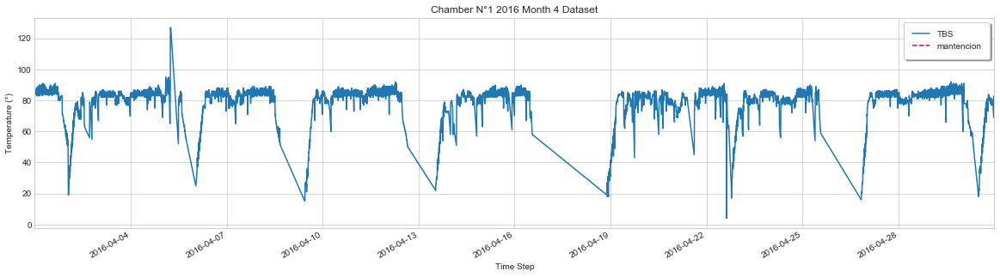

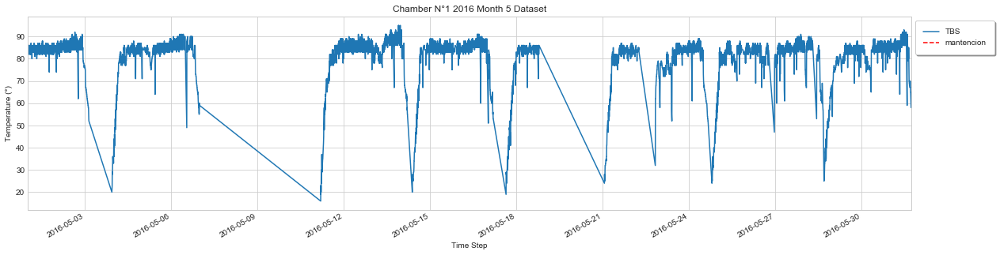

...

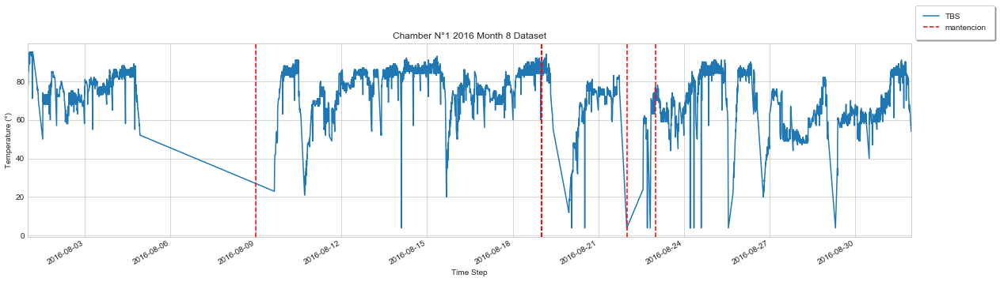

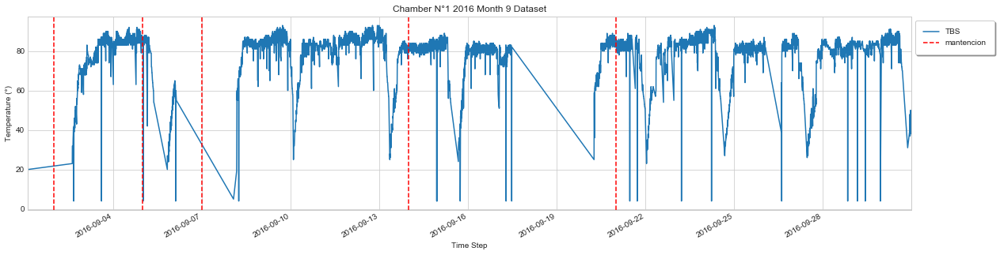

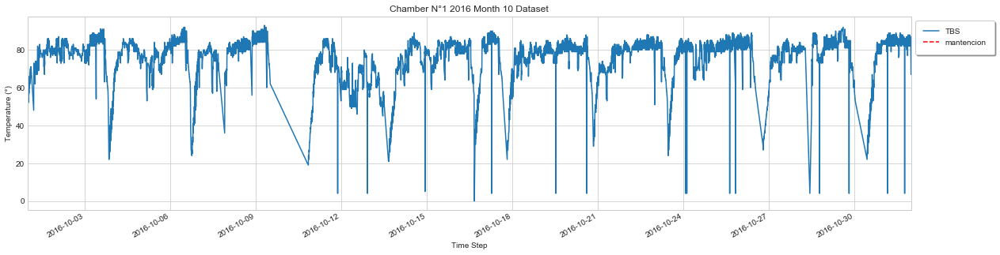

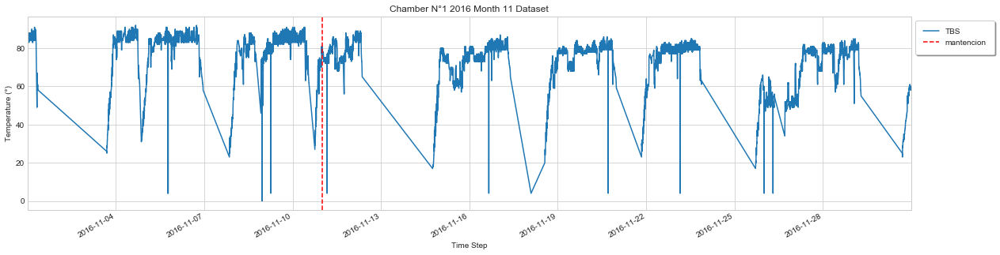

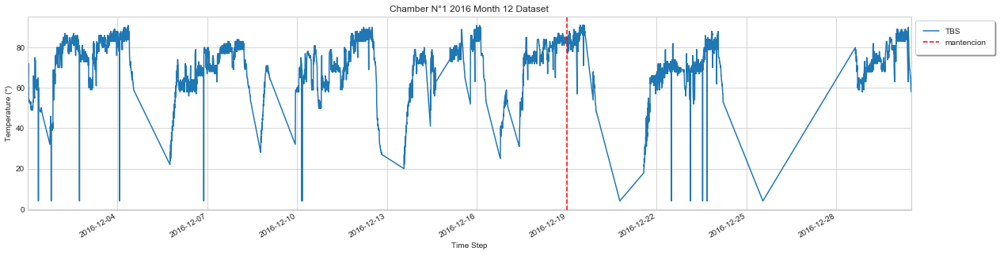

In [103]:
#revisar fin e inicio sec
for i in range(1,13):
    chamber = 1
    year = 2016
    fname = 'chamber_{}_{}_{}data.png'.format(chamber, year, i)
    tname = 'Chamber N°{} {} Month {} Dataset'.format(chamber, year, i)
    start = '2016-0{}'.format(i)
    mantencion = m1
    serie = c1[['TBS']]
    plot_chamber_serie(serie, fname, tname, mantencion=mantencion, start=start, end_dates=proces_ends, start_dates=proces_starts)

108213


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


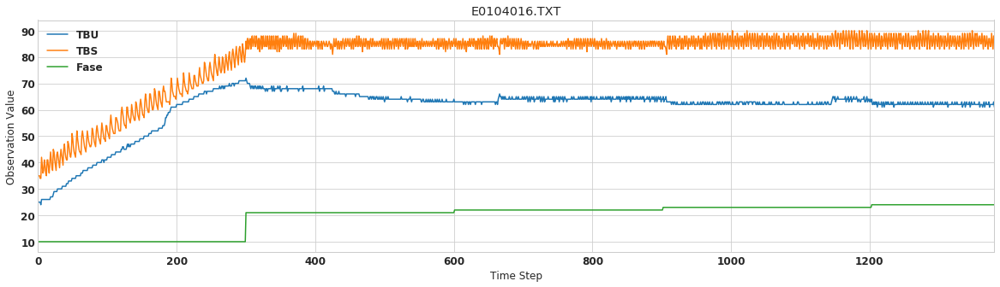

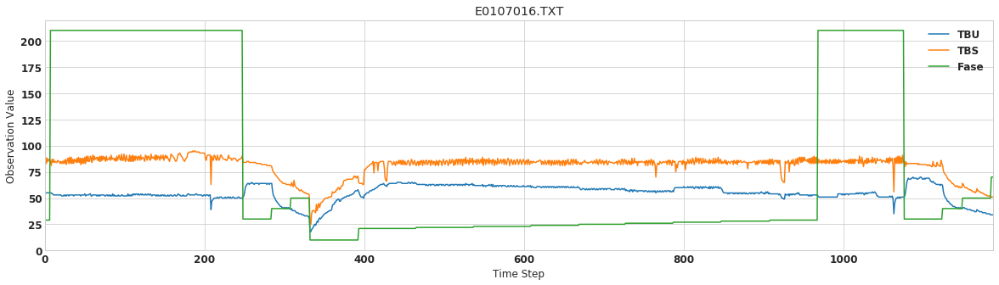

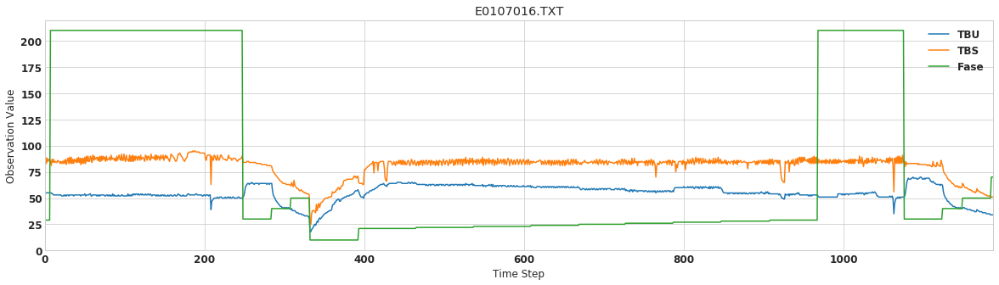

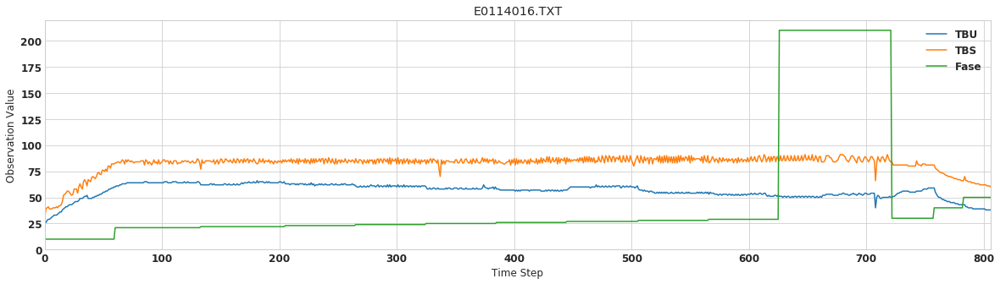

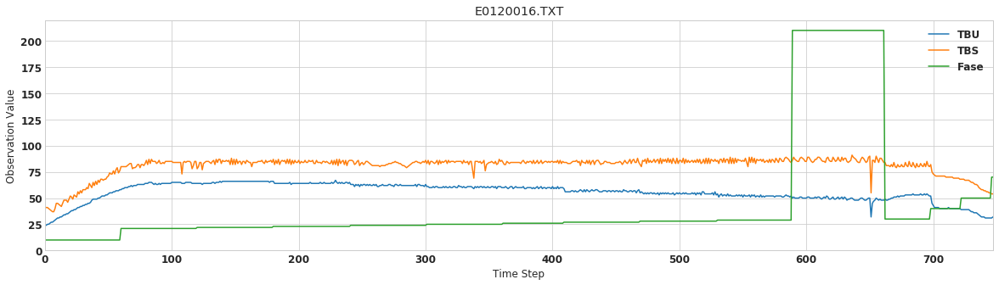

...

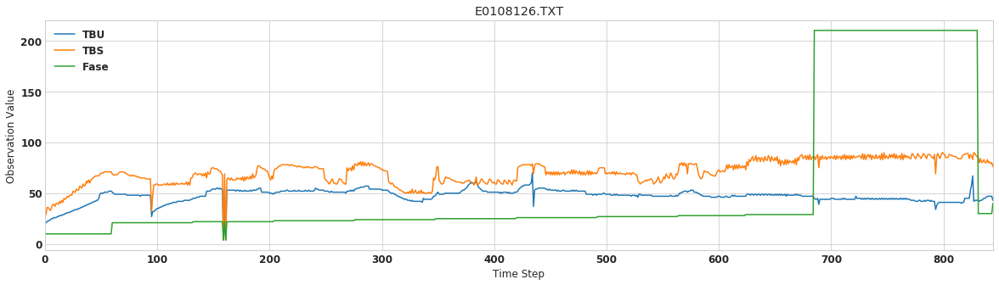

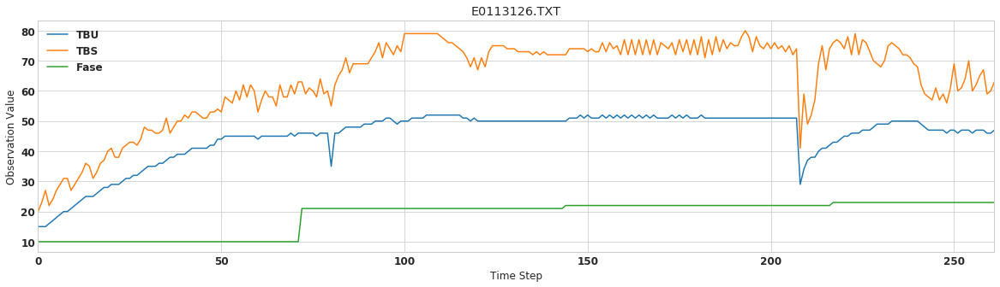

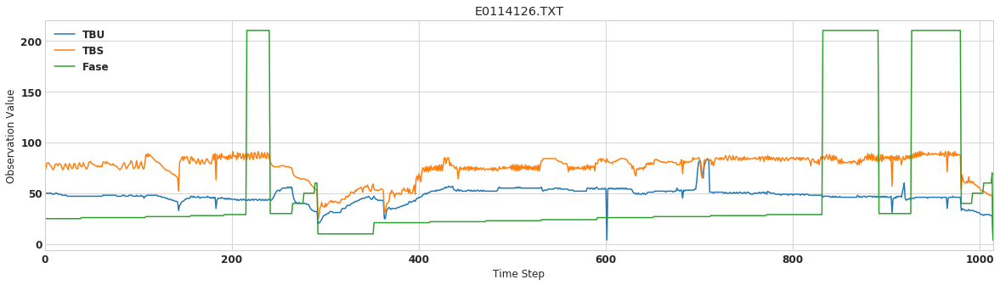

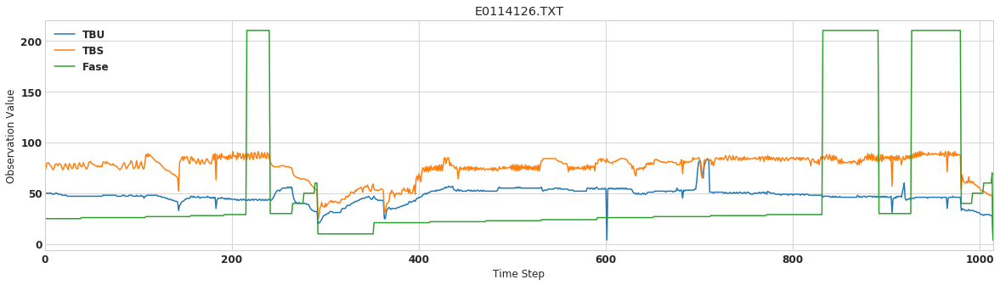

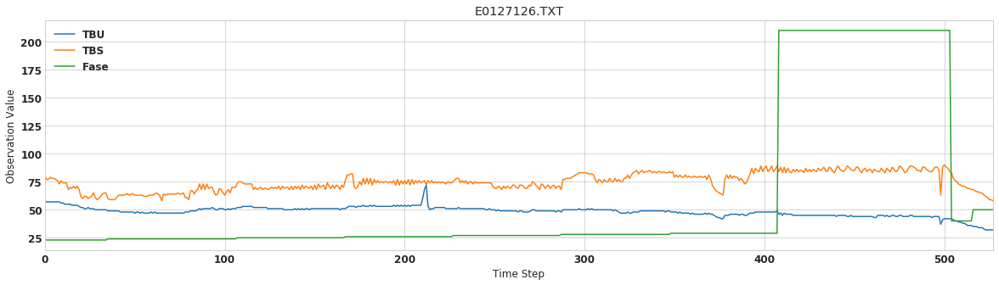

71


In [107]:
print(c1.shape[0])
total = 0
i = 0
step_count = 0
steps = []
proceso = c1.proceso.tolist()[0]
total= 0
# print(proceso)
while i <= c1_2016.shape[0]:
    pname = c1.iloc[i]['proceso']
    pdict = procesos[pname]
    start = str(pdict['inicio'])
    end = str(pdict['termino'])
    steps = pdict['steps']
    
    df = c1.loc[start:end]
    df[['TBU','TBS','Fase']].reset_index().plot(figsize=(20,5))
    plt.title(pname)
    plt.ylabel('Observation Value')
    plt.xlabel('Time Step')
    plt.show()
    
    i += steps
    total += 1
print(total)

# Selecting Normal and Anomaly data

In [24]:
camara = 'E01'
year = '6'
files = ['1401', '2001', '0102', '0604', '0904', '1804', '2204', '2604', '3004', '0305','2405','0206','0406','1806','2206',
        '2906','1508','1908','2508','2608','0209','1009','1309','2209','2409','2709','3009','0310','0610',
        '1010','1310','1610','1710','2010','1011','1411', '2111','2511','0512','0812']
ready_files = [camara + x + year + '.TXT' for x in files]
print(len(ready_files))

df =  c1_2016[c1_2016['proceso'].str.contains('|'.join(ready_files))]
print(c1_2016.shape)
print(df.shape)

40
(68388, 64)
(31077, 64)


In [10]:
df

,Vent,Unkwn1,Unkwn2,Fase,TBS,TBU,UR,Unkwn3,Duracion_fase,UMd,...,Exte7,Exte8,Exte9,Exte10,Exte11,time_step,Unkwn4,Vent_dir,nro_camara,proceso
2016-01-14 21:05:12,,L,0.0,10.0,31.0,25.0,62.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,8219.0,1.0,1,E0114016.TXT
2016-01-14 21:10:12,<-,L,0.0,10.0,39.0,26.0,37.0,0.0,6.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,8476.0,1.0,1,E0114016.TXT
2016-01-14 21:15:12,<-,L,0.0,10.0,40.0,28.0,40.0,0.0,11.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,8476.0,1.0,1,E0114016.TXT
2016-01-14 21:20:12,<-,L,0.0,10.0,41.0,29.0,45.0,0.0,16.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,8733.0,1.0,1,E0114016.TXT
2016-01-14 21:25:12,<-,L,0.0,10.0,39.0,29.0,48.0,0.0,21.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,8990.0,1.0,1,E0114016.TXT
2016-01-14 21:30:12,<-,L,0.0,10.0,39.0,30.0,55.0,0.0,26.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,9247.0,1.0,1,E0114016.TXT
2016-01-14 21:35:12,<-,L,0.0,10.0,39.0,31.0,56.0,0.0,31.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,9504.0,1.0,1,E0114016.TXT
2016-01-14 21:40:13,<-,L,0.0,10.0,40.0,32.0,56.0,0.0,36.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,9761.0,1.0,1,E0114016.TXT
2016-01-14 21:45:13,<-,L,0.0,10.0,40.0,33.0,60.0,0.0,41.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,10018.0,1.0,1,E0114016.TXT
2016-01-14 21:50:13,<-,L,0.0,10.0,40.0,33.0,60.0,0.0,46.0,0.0,...,0.0,0.0,0.0,0.0,0.0,5.0,10275.0,1.0,1,E0114016.TXT


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


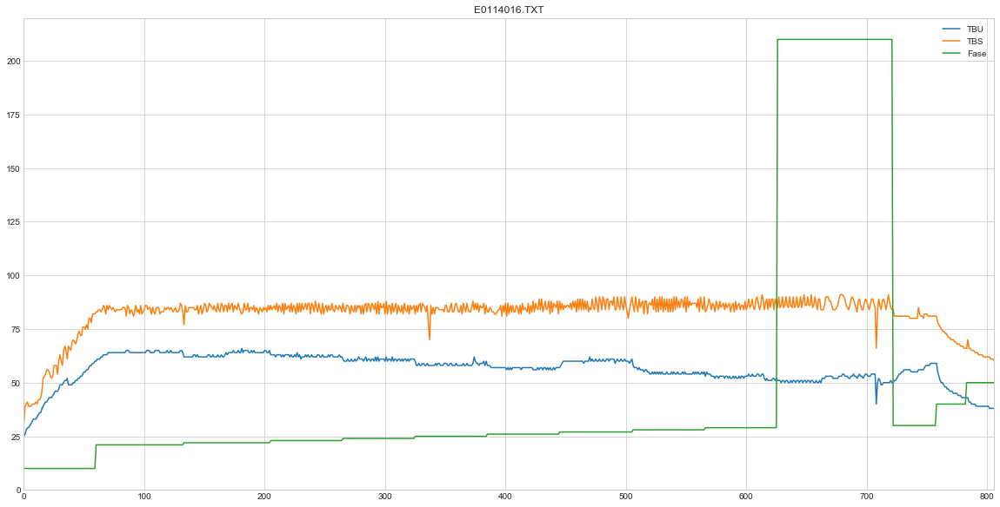

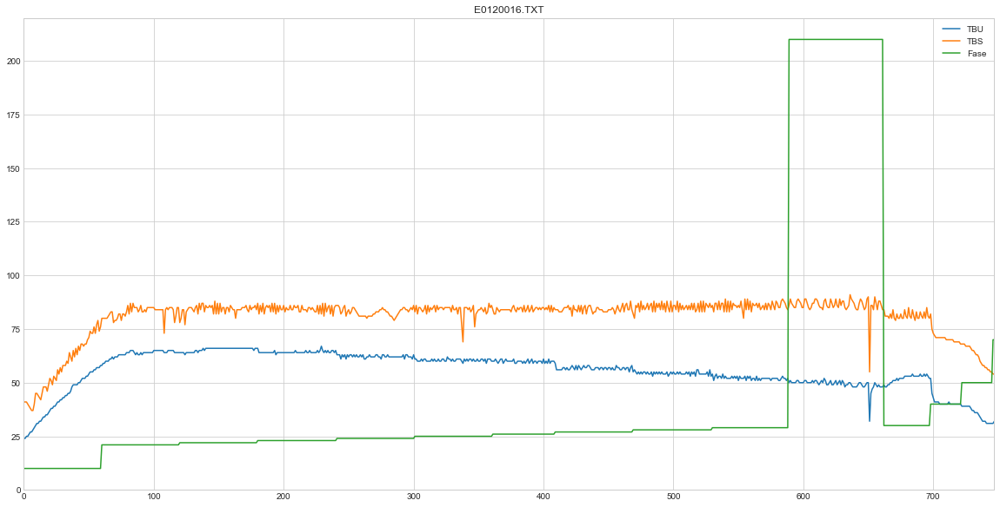

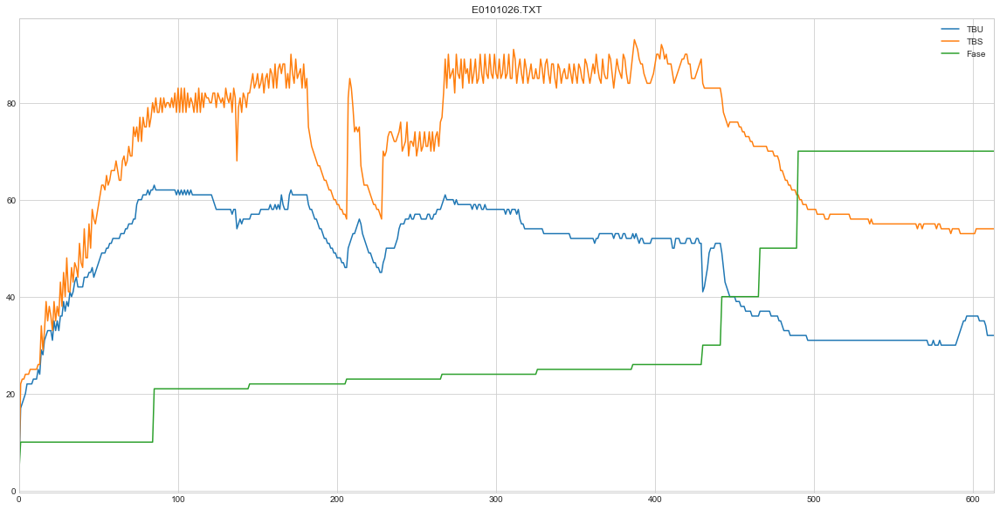

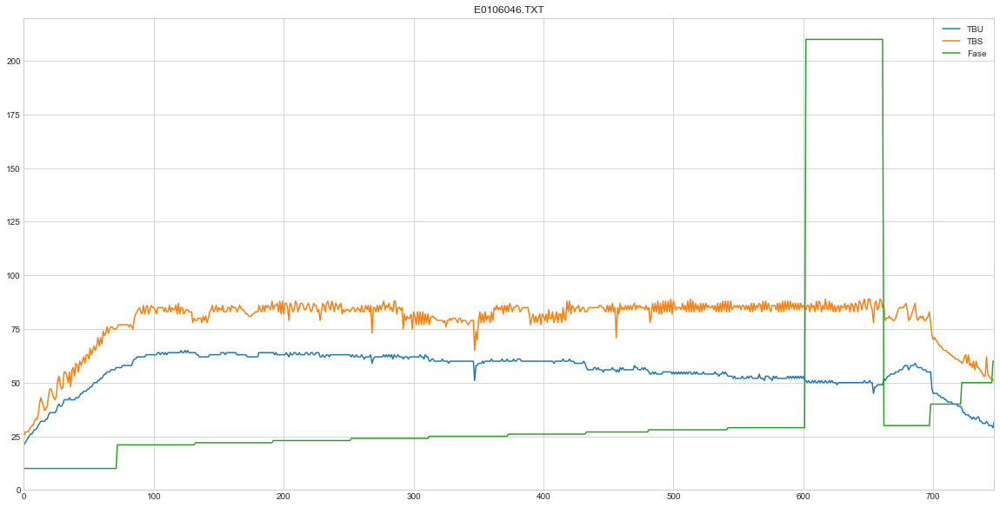

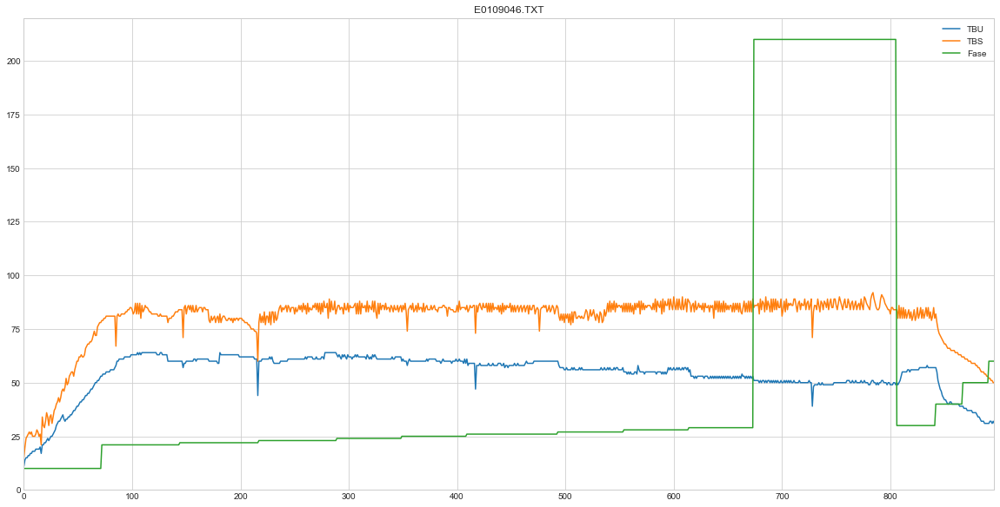

...

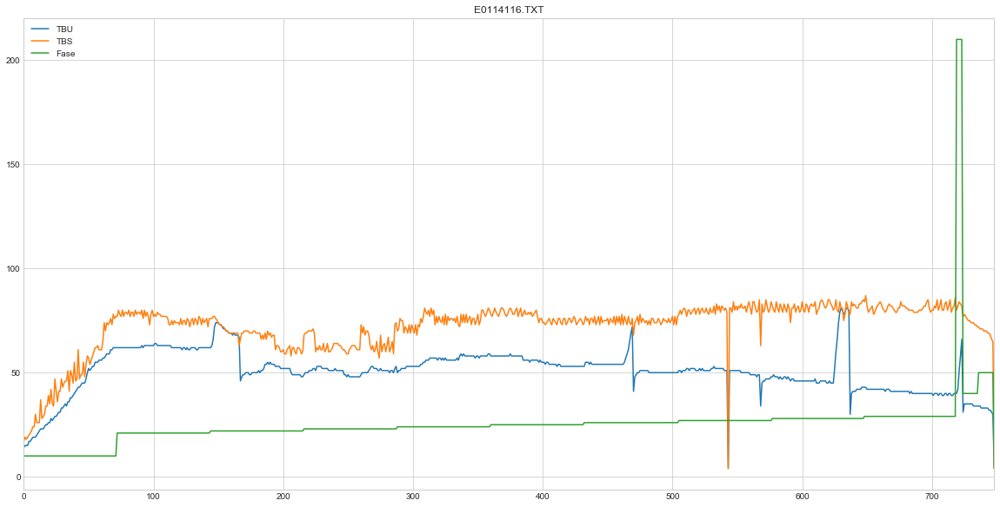

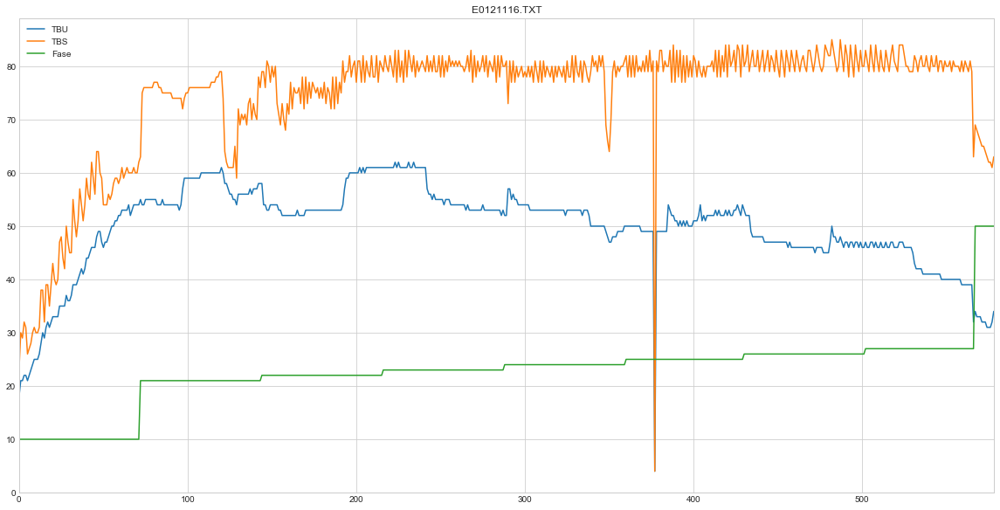

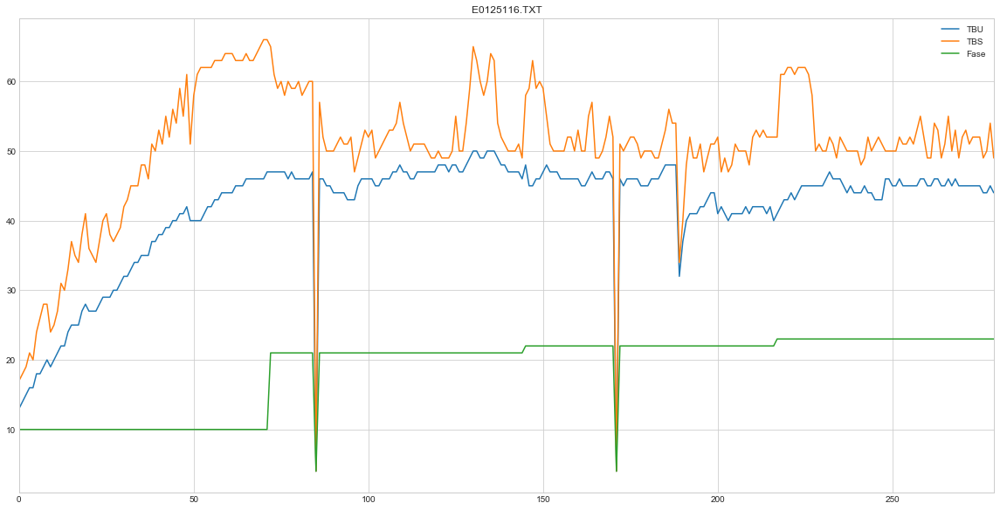

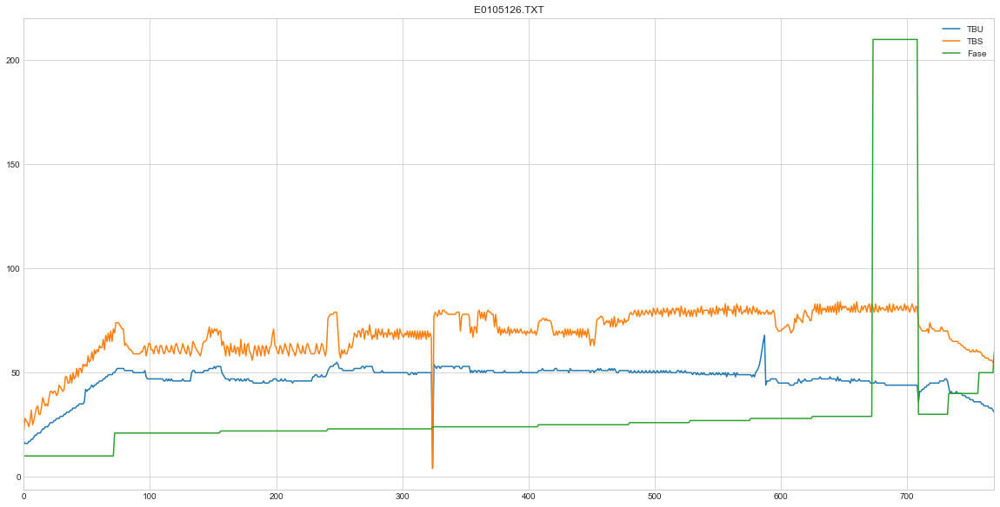

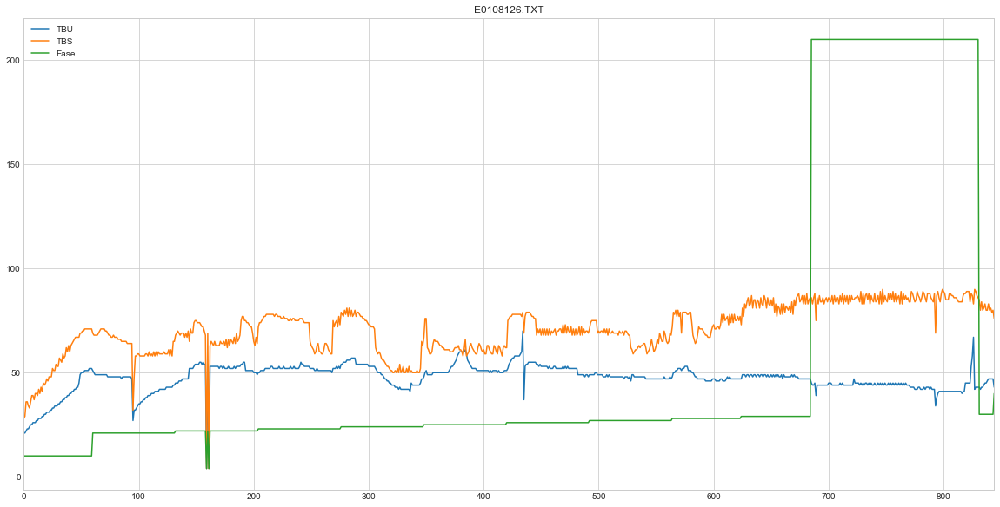

In [25]:
total = 0
i = 0
step_count = 0
steps = []
proceso = df.proceso.tolist()[0]
total= 0
# print(df.proceso.nunique())
# print(proceso)
for p in df.proceso.unique():
    tmp = df[df['proceso']==p]
    tmp[['TBU','TBS','Fase']].reset_index().plot(figsize=(20,10))
    plt.title(p)

In [93]:
camara = 'E01'
year = '6'
anomalies_test = ['1401', '0102', '2204', '0305', '2405','1908', '2608', '2409', '3009', '0310', '1010', '1011']
anomalies_val1 = ['0206', '0406', '1806', '2206', '1508']
normal = ['2001', '0604', '0904', '1804', '2604', '3004', '2906', '2508', '1309', '2209',
          '2508', '0209', '1309', '2209', '2709', '1710', '2010']

print('Test T Size', len(anomalies_test))
print('Test Val Size', len(anomalies_val1))
print('Test N Size', len(normal))

ready_anomalies_test = [camara + x + year + '.TXT' for x in anomalies_test]
ready_anomalies_val1 = [camara + x + year + '.TXT' for x in anomalies_val1]
ready_normal = [camara + x + year + '.TXT' for x in normal]

c1_2016['anomaly'] = 0

anomaly_test_set =  c1_2016[c1_2016['proceso']\
                            .str.contains('|'.join(ready_anomalies_test))][['TBS', 'anomaly']]
anomaly_val1_set =  c1_2016[c1_2016['proceso']\
                            .str.contains('|'.join(ready_anomalies_val1))][['TBS', 'anomaly']]
normal_set =  c1_2016[c1_2016['proceso']\
                      .str.contains('|'.join(ready_normal))][['TBS', 'anomaly']]

print('\nTotal Year ', c1_2016.shape)
print('Test ', anomaly_test_set.shape)
print('Val1 ', anomaly_val1_set.shape)
print('Normal ', normal_set.shape)
# print(len(ready_files))

Test T Size 12
Test Val Size 5
Test N Size 17

Total Year  (68388, 65)
Test  (10053, 2)
Val1  (4279, 2)
Normal  (10779, 2)


C:\Users\joaquin\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


In [71]:
df_train = normal_set.copy()
df_test = anomaly_test_set.copy()
df_validation1 = anomaly_val1_set.copy()
df_validation2 = anomaly_test_set.copy()


Size of train: 10779
Size of test: 10053
Size of validation1: 4279
Size of validation2: 10053
Total: 35164
Ratio of train: 0.306535
Ratio of test: 0.285889
Ratio of validation1: 0.121687
Ratio of validation2: 0.285889


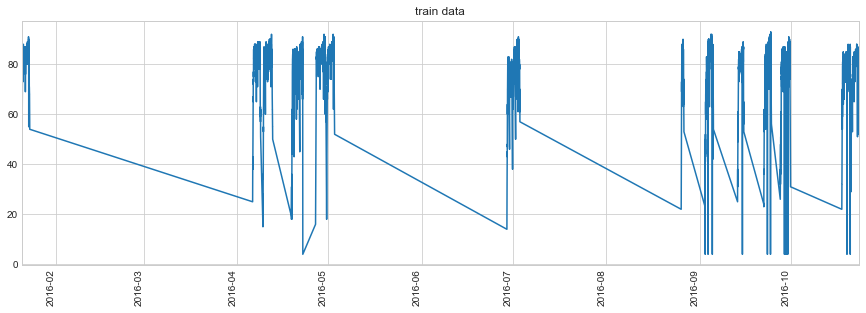

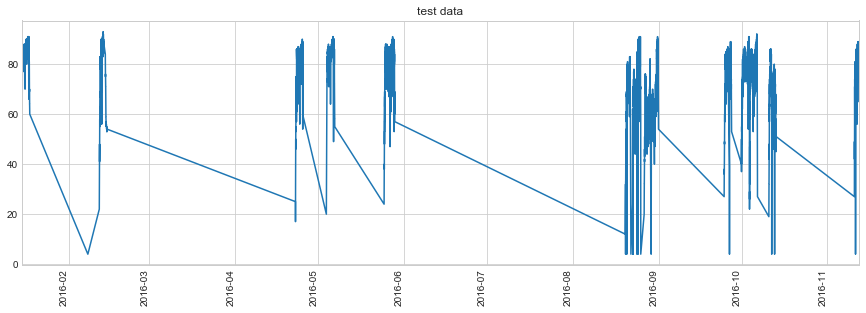

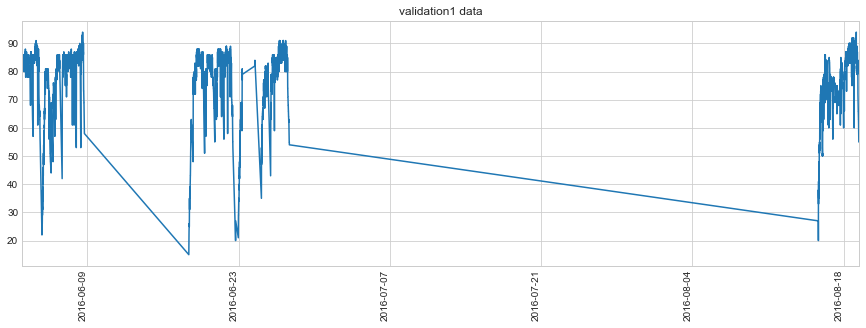

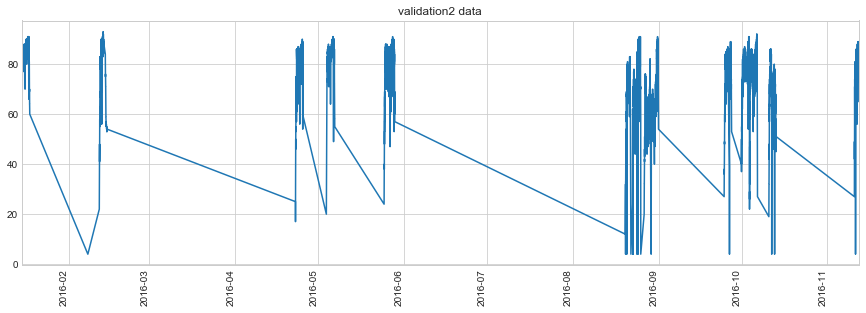

In [72]:
df_dict = {}
df_dict['train'] = df_train
df_dict['test'] = df_test
df_dict['validation1'] = df_validation1
df_dict['validation2'] = df_validation2

count = 0
for key in df_dict:
    print ("Size of %s: %d"%(key,df_dict[key].shape[0]))
    count += df_dict[key].shape[0]
print ("Total: %d"%(count))

for key in df_dict:
    print ("Ratio of %s: %f"%(key,float(df_dict[key].shape[0])/count))

    
for key in df_dict:
    df_tmp = df_dict[key]
    plt.figure()
    df_tmp['TBS'].plot(figsize=(15,5))
    rows = df_tmp[df_tmp.anomaly.isin([1])].itertuples()
    for row in rows:
        print (row)
        plt.plot(row[0], row[1], 'r.', markersize=10.0)
    plt.xticks(rotation='vertical')
    plt.title("%s data"%(key))
    plt.show()

In [73]:
for key in df_dict:
    np.save("..\\lstm_anomaly_thesis\\resources\\data\\discords\\AH\\%s"%(key),df_dict[key])

In [46]:
#Detection code starts here
#Detection code starts here
#Detection code starts here
#Detection code starts here

In [117]:
data_folder = "..\\lstm_anomaly_thesis\\resources\\data\\discords\\AH\\"

In [118]:
#load training data
train_predictions = np.load(data_folder+"train_predictions.npy")
train_true = np.load(data_folder+"train_true.npy")
print (train_predictions.shape)
print (train_true.shape)


(10743, 12)
(10743,)


In [119]:
#load validation2 data
validation2_predictions = np.load(data_folder+"validation2_predictions.npy")
validation2_true = np.load(data_folder+"validation2_true.npy")
validation2_labels = np.load(data_folder+"validation2_labels.npy")
print (np.shape(validation2_predictions))
print (np.shape(validation2_true))
print (np.shape(validation2_labels))
validation2_labels = np.reshape(validation2_labels,[len(validation2_labels),np.shape(validation2_labels)[1]])
print (np.shape(validation2_labels))

(10040, 1)
(10040,)
(10040, 1, 1)
(10040, 1)


In [120]:
# load test data
test_predictions = np.load(data_folder+"test_predictions.npy")
test_true = np.load(data_folder+"test_true.npy")
test_labels = np.load(data_folder+"test_labels.npy")
print (np.shape(test_predictions))
print (np.shape(test_true))
test_labels = np.reshape(test_labels,[len(test_labels),np.shape(test_labels)[1]])
print (np.shape(test_labels))

(10040, 1)
(10040,)
(10040, 1)


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


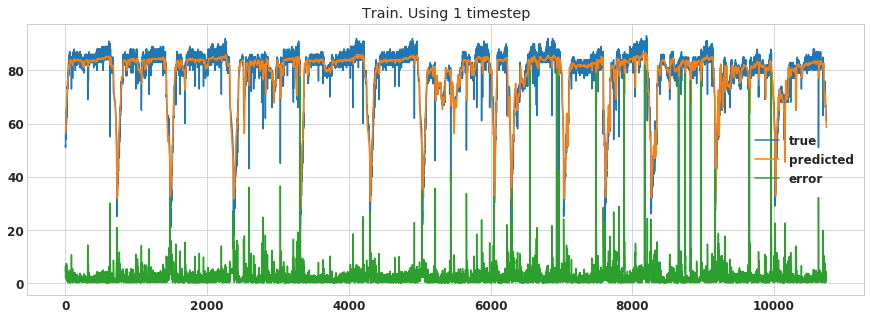

In [121]:
plt.figure(figsize=(15,5))
plt.plot(train_true,label='true')
plt.plot(train_predictions[:,0],label='predicted')
plt.plot(abs(train_true - train_predictions[:,0]), label='error')
plt.legend()
plt.title("Train. Using 1 timestep")
plt.show()

-0.0017276367284083604
4.783985522547946


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


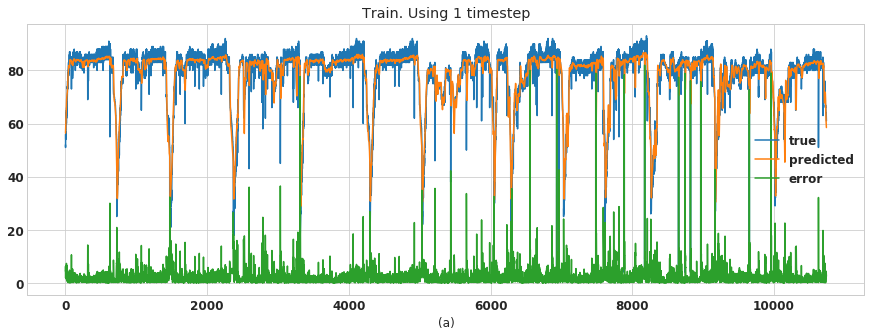

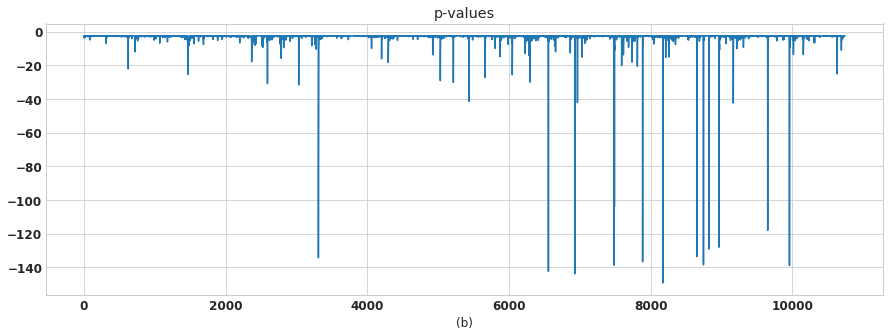

In [122]:
#error vectors
from scipy.stats import norm

train_error_vectors = np.zeros(np.shape(train_predictions))
n_cols = np.shape(train_predictions)[1]
for i in range(n_cols):
    train_error_vectors[:,i] =  train_true -train_predictions[:,i]

#ERROR DIMENSION
error_dimension = 1
train_error_vectors = train_error_vectors[:,0:error_dimension]
mean = np.mean(train_error_vectors)
std = np.std(train_error_vectors)
print (mean)
print (std)
p_values= norm(loc=mean, scale=std).logpdf(train_error_vectors)

plt.figure(figsize=(15,5))
plt.plot(train_true,label='true')
plt.plot(train_predictions[:,0],label='predicted')
plt.plot(abs(train_true - train_predictions[:,0]),label='error')
plt.title("Train. Using 1 timestep")
plt.xlabel("(a)")
plt.legend()

plt.figure(figsize=(15,5))
plt.plot(p_values)
plt.title("p-values")
plt.xlabel("(b)")
plt.show()

train_errors_1 = train_true - train_predictions[:,0]

In [114]:
v2_error_vectors = np.zeros(np.shape(validation2_predictions))
for i in range(n_cols):
    v2_error_vectors[:,i] =  validation2_true -validation2_predictions[:,i]

v2_error_vectors = v2_error_vectors[:,0:error_dimension]
v2_p_values= norm(loc=mean, scale=std).logpdf(v2_error_vectors)

print ()
test_error_vectors = np.zeros(np.shape(test_predictions))
for i in range(n_cols):
    test_error_vectors[:,i] =  test_true -test_predictions[:,i]
test_error_vectors = test_error_vectors[:,0:error_dimension]
test_p_values= norm(loc=mean, scale=std).logpdf(test_error_vectors)

test_true_anomalies = np.where(test_labels[:,0]==1)

(array([ 795, 2179, 4021, 4022, 4023, 4049, 4181, 4515, 4516, 4559, 4565,
       4930, 4933, 4969, 5042, 5304, 5918, 7001, 7005, 9137, 9423, 9705],
      dtype=int64), array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
      dtype=int64))


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


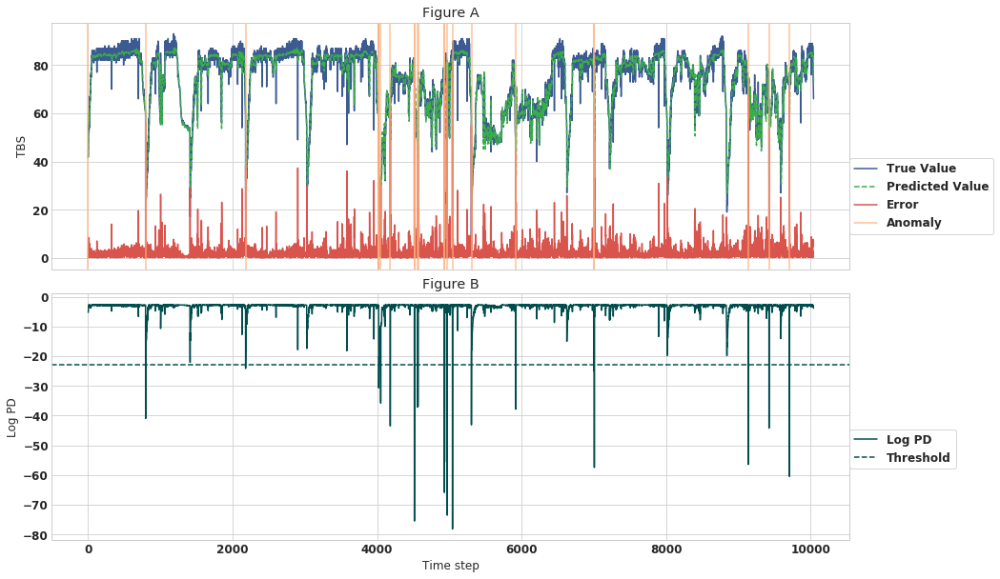

In [123]:
import matplotlib.gridspec as gridspec
threshold_v2 = -23

f = plt.figure(figsize=(15,10))
plt.subplots_adjust(hspace=0.1)

gs1 = gridspec.GridSpec(1, 2)
gs1.update(wspace=0.025, hspace=0.05)

v2_below_threshold = np.where(v2_p_values <= threshold_v2)
print (v2_below_threshold)

ax1 = plt.subplot(211)
ax1.plot(validation2_true,label='True Value',color=sns.xkcd_rgb["denim blue"])
ax1.plot(validation2_predictions[:,0],ls ='dashed',label='Predicted Value',color=sns.xkcd_rgb["medium green"])
ax1.plot(abs(validation2_true - validation2_predictions[:,0]),label='Error',color=sns.xkcd_rgb["pale red"])
ax1.axvline(x=0, color=sns.xkcd_rgb["peach"], alpha=0.8, label='Anomaly')

for column in v2_below_threshold[0]:
    ax1.axvline(x=column,color=sns.xkcd_rgb["peach"],alpha=.8)
#for row in v2_true_anomalies:
#    plt.plot(row, validation2_true[row], 'r.', markersize=20.0)
ax1.legend(bbox_to_anchor=(1,.45),borderaxespad=0.,frameon=True)
ax1.set_title('Figure A')
plt.ylabel("TBS")
#plt.title("Validation2. Using 1 timestep")


#plot v2 log PD
ax2 = plt.subplot(212, sharex=ax1)
ax2.plot(v2_p_values,label='Log PD',color=sns.xkcd_rgb["dark teal"])
ax2.axhline(y=threshold_v2,ls='dashed',label='Threshold',color=sns.xkcd_rgb["dark teal"])
ax2.legend(bbox_to_anchor=(1, .45), borderaxespad=0.,frameon=True)
ax2.set_title('Figure B')
# ax2.text(.5, .05, '(b)', ha='center')
plt.ylabel("Log PD")

#plt.title("Validation2 p-values")

#Set up the xlabel and xtick
#xticklabels = ax1.get_xticklabels() + ax2.get_xticklabels()
xticklabels = ax1.get_xticklabels()
plt.setp(xticklabels, visible=False)
plt.xlabel("Time step")
plt.show()
pp = PdfPages('AH.pdf')
pp.savefig(f)
pp.close()

C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


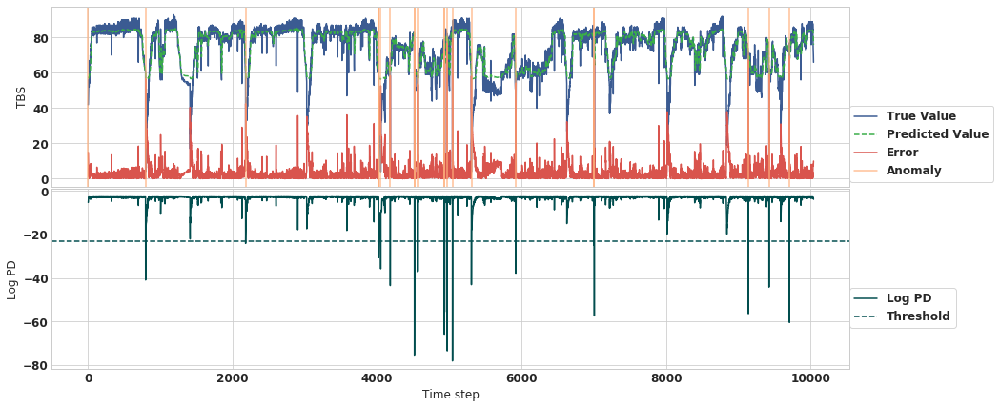

PermissionError: [Errno 13] Permission denied: 'AH_test.pdf'

In [116]:
test_below_threshold = np.where(test_p_values <= threshold_v2)
#plot test data
f = plt.figure(figsize=(15,7))
plt.subplots_adjust(hspace=0.01)

ax1 = plt.subplot(211)
ax1.plot(test_true, label='True Value', color=sns.xkcd_rgb["denim blue"])
ax1.plot(test_predictions[:,0], ls ='dashed', label='Predicted Value', color=sns.xkcd_rgb["medium green"])
ax1.plot(abs(test_true - test_predictions[:,0]), label='Error', color=sns.xkcd_rgb["pale red"])

ax1.axvline(x=0, color=sns.xkcd_rgb["peach"], alpha=0.8, label='Anomaly')
for column in test_below_threshold[0]:
    ax1.axvline(x=column,color=sns.xkcd_rgb["peach"],alpha=0.8)
#for row in test_true_anomalies:
#    plt.plot(row, test_true[row], 'r.', markersize=20.0)
ax1.legend(bbox_to_anchor=(1, .45), borderaxespad=0.,frameon=True)
plt.ylabel("TBS")
#plt.title("Test. Using 1 timestep")

ax2 = plt.subplot(212, sharex=ax1)
ax2.plot(test_p_values,label='Log PD',color=sns.xkcd_rgb["dark teal"])
ax2.axhline(y=threshold_v2,ls='dashed',label='Threshold',color=sns.xkcd_rgb["dark teal"])
ax2.legend(bbox_to_anchor=(1, .45), borderaxespad=0.,frameon=True)
plt.ylabel("Log PD")
#plt.title("test p-values")

#Set up the xlabel and xtick
#xticklabels = ax1.get_xticklabels() + ax2.get_xticklabels()
xticklabels = ax1.get_xticklabels()
plt.setp(xticklabels, visible=False)
plt.xlabel("Time step")
plt.show()
pp = PdfPages('AH_test.pdf')
pp.savefig(f)
pp.close()

In [124]:
fig = plt.figure(figsize=(15,5))
plt.plot(np.append(np.roll(train_loss,1),train_loss[lookback_limit-1]),label='train')
#plt.plot(test_loss,label='test')
plt.xlim(1, lookback_limit)
plt.xticks(np.arange(1,lookback_limit+1,1))
#plt.legend()
plt.xlabel("Lookback")
plt.ylabel("MSE")
plt.show()
pp = PdfPages('ECG_lookbacks.pdf')
pp.savefig(fig)
pp.close()

NameError: name 'train_loss' is not defined

C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


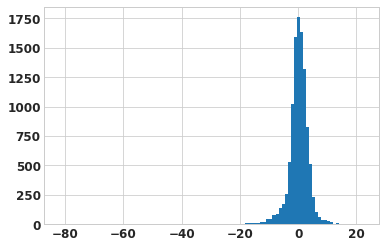

In [125]:
plt.hist(train_error_vectors,bins = 100)
plt.show()

In [126]:
import statsmodels.api as sm

C:\Users\joaquin\Anaconda3\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


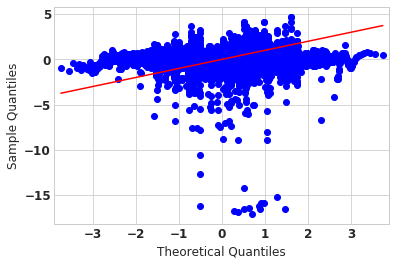

In [127]:
fig = sm.qqplot(train_error_vectors, fit=True,line='s')
plt.show()

C:\Users\joaquin\Anaconda3\lib\site-packages\matplotlib\font_manager.py:1316: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


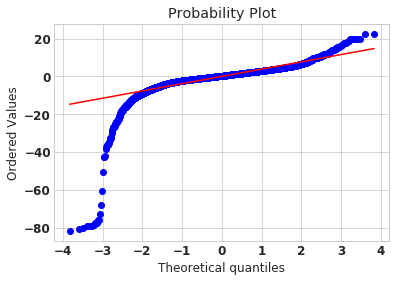

In [130]:
import scipy.stats as stats
import matplotlib.pylab as pylab

error_vectors = np.reshape(train_error_vectors,[len(train_error_vectors)])
stats.probplot(error_vectors, plot=pylab)
plt.show()

In [131]:
stats.normaltest(log_errors)

NameError: name 'log_errors' is not defined

### 5.1.1 Chamber 1: 2017

# Other Analysis